In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
image = "redom_svi3.jpg"

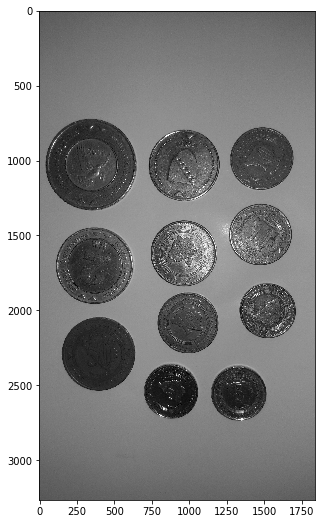

In [3]:
img = cv2.imread(image, 1)
img_orig = img.copy()
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.rcParams["figure.figsize"] = (16, 9)
plt.imshow(img, cmap='gray')

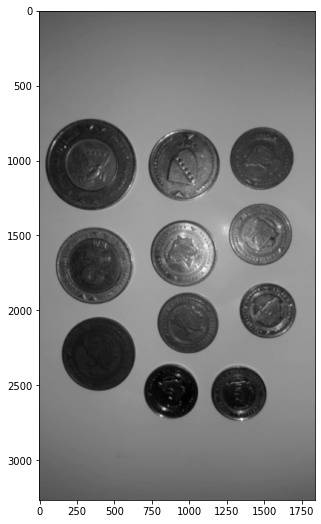

In [4]:
img = cv2.GaussianBlur(img, (21, 21), cv2.BORDER_DEFAULT)
plt.rcParams["figure.figsize"]=(16, 9)
plt.imshow(img, cmap='gray')

In [5]:
all_circles = cv2.HoughCircles(img, cv2.HOUGH_GRADIENT, 0.9, 120, param1 = 50, param2 = 30, minRadius = 150, maxRadius = 320)
all_circles_rounded = np.uint16(np.around(all_circles))

In [6]:
print (all_circles_rounded)
print (all_circles_rounded.shape)
print ('Founded ' + str(all_circles_rounded.shape[1]) + ' coins')

[[[ 368 1702  256]
  [ 348 1028  305]
  [ 992 2084  203]
  [ 398 2290  246]
  [ 964 1622  222]
  [ 966 1032  236]
  [1480 1494  204]
  [1488  998  219]
  [1518 2000  185]
  [ 880 2540  182]
  [1332 2556  181]]]
(1, 11, 3)
Founded 11 coins


In [7]:
sum = 0
counter = 0

lower_bound_first_coin = 178
upper_bound_first_coin = 187
lower_bound_second_coin = 187
upper_bound_second_coin = 220
lower_bound_third_coin = 220
upper_bound_third_coin = 230
lower_bound_fourth_coin = 230
upper_bound_fourth_coin = 240
lower_bound_fifth_coin = 240
upper_bound_fifth_coin = 250
lower_bound_sixth_coin = 250
upper_bound_sixth_coin = 290
lower_bound_seventh_coin = 290
upper_bound_seventh_coin = 330

for i in all_circles_rounded[0, :]:
    cv2.circle(img_orig, (i[0], i[1]), i[2], (255, 0, 0), 5)
    if(i[2] >= lower_bound_first_coin and i[2] < upper_bound_first_coin):
        cv2.putText(img_orig, "0.05", (i[0]-70, i[1]+30), cv2.FONT_HERSHEY_SIMPLEX, 2.2, (255, 0, 0), 2)
        sum += 0.05
    elif(i[2] >= lower_bound_second_coin and i[2] < upper_bound_second_coin):
        cv2.putText(img_orig, "0.10", (i[0]-70, i[1]+30), cv2.FONT_HERSHEY_SIMPLEX, 2.2, (255, 0, 0), 2)
        sum += 0.1
    elif(i[2]>=lower_bound_third_coin and i[2]< upper_bound_third_coin):
        cv2.putText(img_orig, "0.20", (i[0]-70, i[1]+30), cv2.FONT_HERSHEY_SIMPLEX, 2.2, (255, 0, 0), 2)
        sum += 0.2
    elif(i[2] >= lower_bound_fourth_coin and i[2] < upper_bound_fourth_coin):
        cv2.putText(img_orig, "1.00", (i[0]-70, i[1]+30), cv2.FONT_HERSHEY_SIMPLEX, 2.2, (255, 0, 0), 2)
        sum += 1.0
    elif(i[2] >= lower_bound_fifth_coin and i[2]< upper_bound_fifth_coin):
        cv2.putText(img_orig, "0.50", (i[0]-70, i[1]+30), cv2.FONT_HERSHEY_SIMPLEX, 2.2, (255, 0, 0), 2)
        sum += 0.5
    elif(i[2] >= lower_bound_sixth_coin and i[2] < upper_bound_sixth_coin):
        cv2.putText(img_orig, "2.00", (i[0]-70, i[1]+30), cv2.FONT_HERSHEY_SIMPLEX, 2.2, (255, 0, 0), 2)
        sum += 2.0
    elif(i[2] >= lower_bound_seventh_coin and i[2] < upper_bound_seventh_coin):
        cv2.putText(img_orig, "5.00", (i[0]-70, i[1]+30), cv2.FONT_HERSHEY_SIMPLEX, 2.2, (255, 0, 0), 2)
        sum += 5.0

True

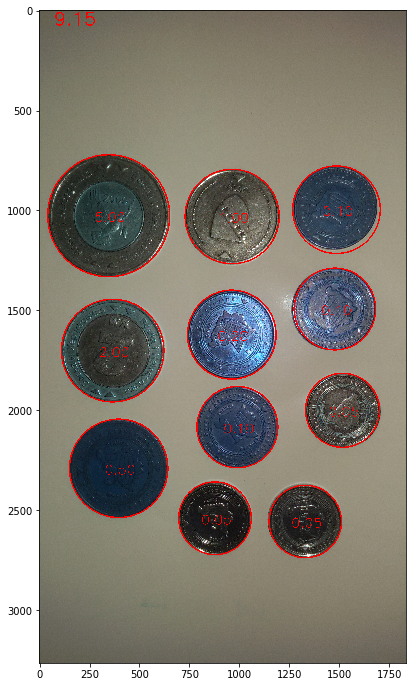

In [13]:
cv2.putText(img_orig, str(round(sum, 2)), (75, 75), cv2.FONT_HERSHEY_SIMPLEX, 3, (255, 0, 0), 5)
import mpld3
mpld3.enable_notebook()
plt.figure(figsize=(13, 12))
plt.imshow(img_orig)
cv2.imwrite('rez.jpg',img_orig)